# **Edible and Poisonous Mushroom Classification with CNN**

In [ ]:
import os
import cv2
import matplotlib.pyplot as plt
import numpy as np
import shutil
import hashlib
from PIL import Image
import pandas as pd
from sklearn.model_selection import train_test_split
from tensorflow.keras.layers import Dropout
from tensorflow.keras.regularizers import l2
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, Flatten
import tensorflow as tf
from sklearn.metrics import classification_report, confusion_matrix
import seaborn as sns
from tensorflow.keras.layers import Dropout
from tensorflow.keras.regularizers import l2
from tensorflow.keras.utils import to_categorical
from sklearn.preprocessing import LabelEncoder
from tensorflow.keras.applications import EfficientNetV2B0

In [ ]:
# Path ke dataset Anda
dataset_path = 'C:/Users/fatur/Documents/Datasets/Dataset edible and poisonous fungi'

In [ ]:
# List dari folder yang ingin Anda gunakan
folders = ['edible mushroom sporocarp', 'edible sporocarp', 'poisonous mushroom sporocarp', 'poisonous sporocarp']

# Dictionary untuk menyimpan data
data_ori = {}

for folder in folders:
    # Cek apakah folder ada di dataset
    if folder in os.listdir(dataset_path):
        # List semua file dalam folder
        files = os.listdir(os.path.join(dataset_path, folder))

        # List untuk menyimpan gambar
        images = []

        for file in files:
            # Baca gambar
            img = cv2.imread(os.path.join(dataset_path, folder, file))

            # Tambahkan gambar ke list
            images.append(img)

        # Tambahkan list gambar ke dictionary data
        data_ori[folder] = images

In [ ]:
# List untuk menyimpan semua data
all_data_ori = []

# Ambil nama folder dan gambar dari dictionary data
for folder, images in data_ori.items():
    for img in images:
        # Tambahkan informasi gambar ke list
        all_data_ori.append([str(img), folder, str(img.shape)])

# Ubah list menjadi DataFrame
df_ori = pd.DataFrame(all_data_ori, columns=['Image', 'Label', 'Image Size'])

print(df_ori.all)

# Tampilkan tipe data
print("\nTipe Data:\n")
print(df_ori.dtypes)

# Tampilkan jumlah data
print("\nJumlah Data:\n")
print(df_ori.count())


<bound method DataFrame.all of                                                   Image  \
0     [[[ 74 106  89]\n  [ 55  87  70]\n  [ 33  66  ...   
1     [[[ 83  99  76]\n  [ 75  91  68]\n  [ 62  78  ...   
2     [[[22 15 20]\n  [28 22 23]\n  [37 34 30]\n  .....   
3     [[[ 4  6  6]\n  [ 4  6  6]\n  [ 5  7  7]\n  .....   
4     [[[ 49  64  60]\n  [ 49  64  60]\n  [ 48  65  ...   
...                                                 ...   
3383  [[[202 208 251]\n  [202 208 251]\n  [202 208 2...   
3384  [[[ 90 175 153]\n  [ 89 174 152]\n  [ 89 174 1...   
3385  [[[52 91 93]\n  [37 75 77]\n  [25 58 61]\n  .....   
3386  [[[ 11  32  47]\n  [ 46  30  47]\n  [ 38   0  ...   
3387  [[[ 83  87  82]\n  [ 80  84  79]\n  [ 62  65  ...   

                          Label     Image Size  
0     edible mushroom sporocarp  (194, 259, 3)  
1     edible mushroom sporocarp  (275, 183, 3)  
2     edible mushroom sporocarp  (183, 275, 3)  
3     edible mushroom sporocarp  (194, 259, 3)  
4     edible mu

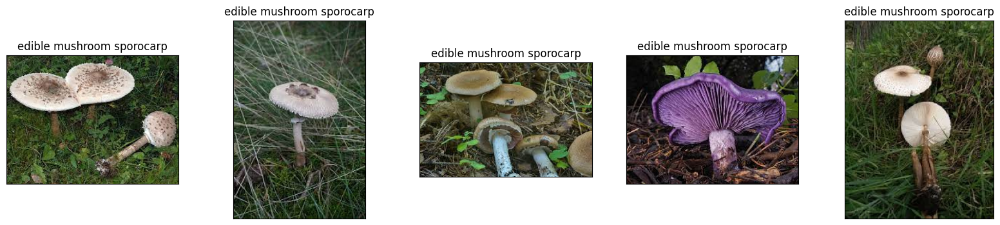

Folder: edible mushroom sporocarp
Jumlah gambar: 710
Tipe data gambar: <class 'numpy.ndarray'>
Ukuran gambar: (194, 259, 3)




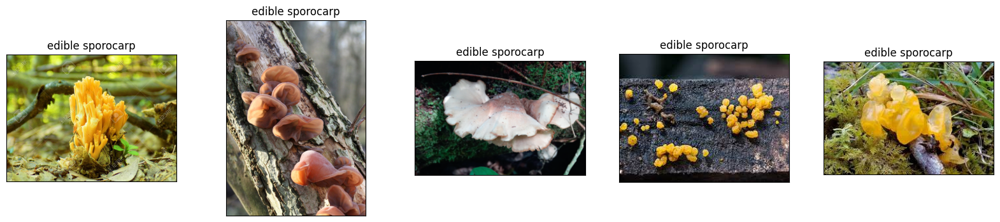

Folder: edible sporocarp
Jumlah gambar: 468
Tipe data gambar: <class 'numpy.ndarray'>
Ukuran gambar: (974, 1300, 3)




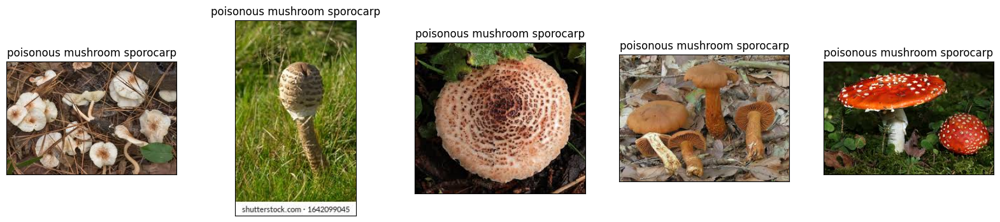

Folder: poisonous mushroom sporocarp
Jumlah gambar: 855
Tipe data gambar: <class 'numpy.ndarray'>
Ukuran gambar: (183, 275, 3)




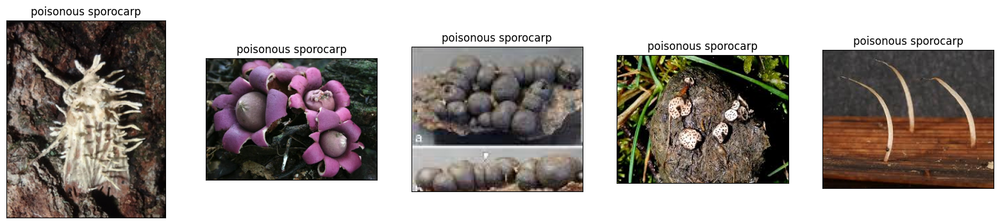

Folder: poisonous sporocarp
Jumlah gambar: 1355
Tipe data gambar: <class 'numpy.ndarray'>
Ukuran gambar: (240, 193, 3)




In [ ]:
# Ambil nama folder dan gambar dari dictionary data
for folder, images in data_ori.items():
    # Buat figure baru
    fig = plt.figure(figsize=(20, 4))

    # Ambil 5 gambar pertama dari setiap folder
    for i in range(5):
        # Buat subplot untuk setiap gambar
        ax = fig.add_subplot(1, 5, i+1, xticks=[], yticks=[])

        # Tampilkan gambar
        ax.imshow(cv2.cvtColor(images[i], cv2.COLOR_BGR2RGB))

        # Beri judul berdasarkan nama folder
        ax.set_title(folder)

    # Tampilkan plot
    plt.show()

    # Cetak informasi tentang dataset
    print(f"Folder: {folder}")
    print(f"Jumlah gambar: {len(images)}")
    print(f"Tipe data gambar: {type(images[0])}")
    print(f"Ukuran gambar: {images[0].shape}")

    # Cetak pembatas
    print("\n")

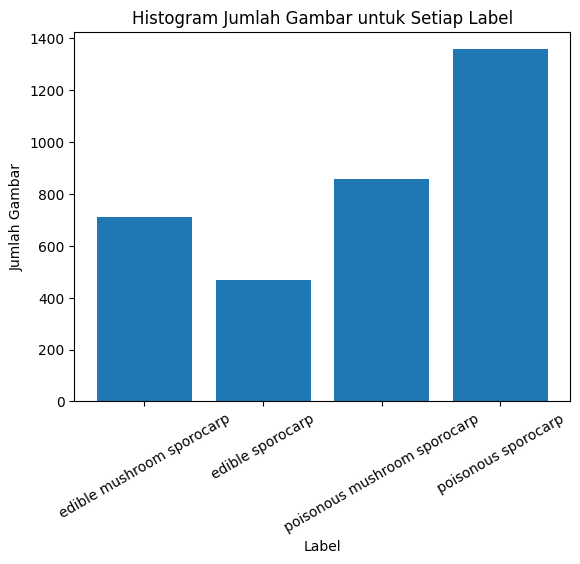

In [ ]:
folders = ['edible mushroom sporocarp', 'edible sporocarp', 'poisonous mushroom sporocarp', 'poisonous sporocarp']

# List untuk menyimpan jumlah gambar
num_images = []

# Ambil nama folder dan gambar dari dictionary data
for folder, images in data_ori.items():
    num_images.append(len(images))

# Buat histogram
plt.bar(data_ori.keys(), num_images)

# Beri label sumbu
plt.xlabel('Label')
plt.ylabel('Jumlah Gambar')

# Putar label pada sumbu x
plt.xticks(rotation=30)

# Beri judul plot
plt.title('Histogram Jumlah Gambar untuk Setiap Label')

# Tampilkan plot
plt.show()

In [ ]:
# Ukuran target
target_size = (224, 224)

# List untuk menyimpan semua data
all_data_ori = []

for folder, images in data_ori.items():
    for img in images:
        # Resize gambar ke ukuran target
        resized_img = cv2.resize(img, target_size)

        # Tambahkan gambar ke list
        all_data_ori.append(resized_img)

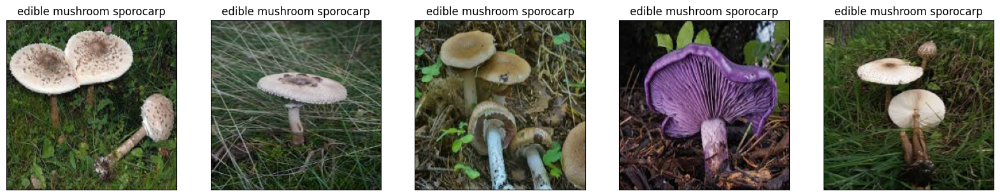

Folder: edible mushroom sporocarp
Jumlah gambar: 710
Tipe data gambar: <class 'numpy.ndarray'>
Ukuran gambar: (194, 259, 3)




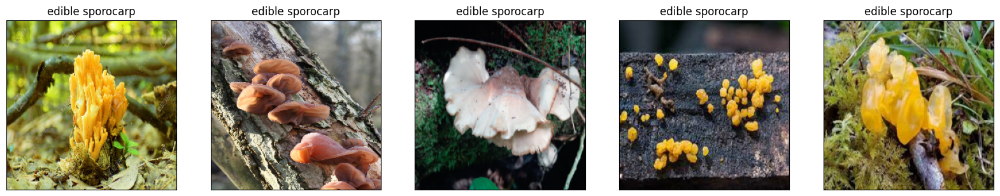

Folder: edible sporocarp
Jumlah gambar: 468
Tipe data gambar: <class 'numpy.ndarray'>
Ukuran gambar: (974, 1300, 3)




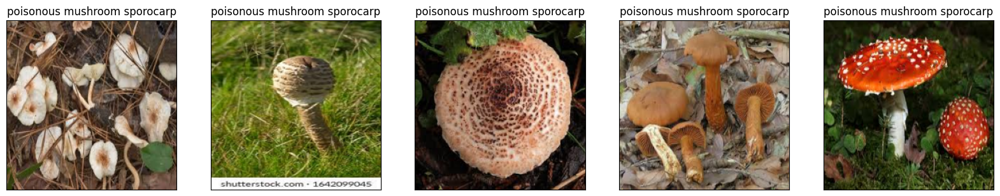

Folder: poisonous mushroom sporocarp
Jumlah gambar: 855
Tipe data gambar: <class 'numpy.ndarray'>
Ukuran gambar: (183, 275, 3)




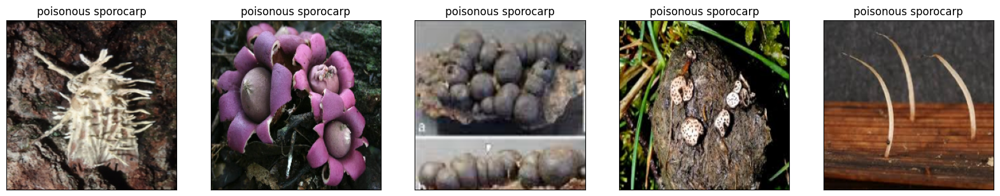

Folder: poisonous sporocarp
Jumlah gambar: 1355
Tipe data gambar: <class 'numpy.ndarray'>
Ukuran gambar: (240, 193, 3)




In [ ]:
# Ambil nama folder dan gambar dari dictionary data
for folder, images in data_ori.items():
    # Buat figure baru
    fig = plt.figure(figsize=(20, 4))

    # Ambil 5 gambar pertama dari setiap folder
    for i in range(5):
        # Buat subplot untuk setiap gambar
        ax = fig.add_subplot(1, 5, i+1, xticks=[], yticks=[])

        # Resize gambar ke ukuran target
        resized_img = cv2.resize(images[i], target_size)

        # Tampilkan gambar
        ax.imshow(cv2.cvtColor(resized_img, cv2.COLOR_BGR2RGB))

        # Beri judul berdasarkan nama folder
        ax.set_title(folder)

    # Tampilkan plot
    plt.show()

    # Cetak informasi tentang dataset
    print(f"Folder: {folder}")
    print(f"Jumlah gambar: {len(images)}")
    print(f"Tipe data gambar: {type(images[0])}")
    print(f"Ukuran gambar: {images[0].shape}")

    # Cetak pembatas
    print("\n")


In [ ]:
# Ukuran target
target_size = (224, 224)

# List dari folder yang ingin Anda gabungkan dan folder tujuan
folders_to_merge = {
    'Edible Mushroom': ['edible mushroom sporocarp', 'edible sporocarp'],
    'Poisonous Mushroom': ['poisonous mushroom sporocarp', 'poisonous sporocarp']
}

for target_folder, source_folders in folders_to_merge.items():
    # Buat folder tujuan jika belum ada
    target_path = os.path.join(dataset_path, target_folder)
    os.makedirs(target_path, exist_ok=True)

    for source_folder in source_folders:
        source_path = os.path.join(dataset_path, source_folder)

        # Cek apakah folder ada di dataset
        if source_folder in os.listdir(dataset_path):
            # List semua file dalam folder
            files = os.listdir(source_path)

            for file in files:
                # Baca gambar
                img = cv2.imread(os.path.join(source_path, file))

                # Resize gambar ke ukuran target
                resized_img = cv2.resize(img, target_size)

                # Simpan gambar yang telah diresize ke folder tujuan
                cv2.imwrite(os.path.join(target_path, file), resized_img)


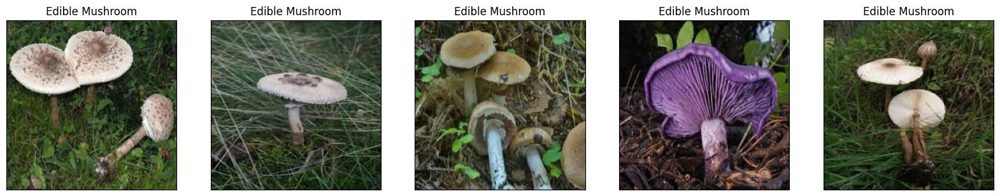

Folder: Edible Mushroom
Jumlah gambar: 1178
Tipe data gambar: <class 'numpy.ndarray'>
Ukuran gambar: (224, 224, 3)




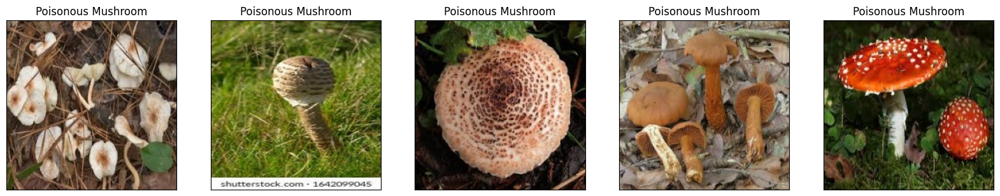

Folder: Poisonous Mushroom
Jumlah gambar: 2210
Tipe data gambar: <class 'numpy.ndarray'>
Ukuran gambar: (224, 224, 3)




In [ ]:
# List dari folder yang ingin Anda cek
folders = ['Edible Mushroom', 'Poisonous Mushroom']

# Dictionary untuk menyimpan data
data = {}

for folder in folders:
    folder_path = os.path.join(dataset_path, folder)

    # List semua file dalam folder
    files = os.listdir(folder_path)

    # List untuk menyimpan gambar
    images = []

    for file in files:
        # Baca gambar
        img = cv2.imread(os.path.join(folder_path, file))

        # Tambahkan gambar ke list
        images.append(img)

    # Tambahkan list gambar ke dictionary data
    data[folder] = images

# Ambil nama folder dan gambar dari dictionary data
for folder, images in data.items():
    # Buat figure baru
    fig = plt.figure(figsize=(20, 4))

    # Ambil 5 gambar pertama dari setiap folder
    for i in range(5):
        # Buat subplot untuk setiap gambar
        ax = fig.add_subplot(1, 5, i+1, xticks=[], yticks=[])

        # Tampilkan gambar
        ax.imshow(cv2.cvtColor(images[i], cv2.COLOR_BGR2RGB))

        # Beri judul berdasarkan nama folder
        ax.set_title(folder)

    # Tampilkan plot
    plt.show()

    # Cetak informasi tentang dataset
    print(f"Folder: {folder}")
    print(f"Jumlah gambar: {len(images)}")
    print(f"Tipe data gambar: {type(images[0])}")
    print(f"Ukuran gambar: {images[0].shape}")

    # Cetak pembatas
    print("\n")

In [ ]:
# List dari folder yang ingin Anda cek
folders = ['Edible Mushroom', 'Poisonous Mushroom']

# Set untuk menyimpan hash gambar
hashes = set()

# Variabel untuk menghitung jumlah gambar duplikat
dup_count = 0

for folder in folders:
    folder_path = os.path.join(dataset_path, folder)

    # List semua file dalam folder
    files = os.listdir(folder_path)

    for file in files:
        file_path = os.path.join(folder_path, file)

        # Buka dan hash gambar
        with Image.open(file_path) as img:
            temp_hash = hashlib.md5(img.tobytes()).hexdigest()

        # Jika hash sudah ada di set, hapus gambar
        if temp_hash in hashes:
            os.remove(file_path)
            print(f'Gambar duplikat ditemukan dan dihapus: {file_path}')
            dup_count += 1
        else:
            hashes.add(temp_hash)

print(f'Total gambar duplikat yang ditemukan dan dihapus: {dup_count}')

Gambar duplikat ditemukan dan dihapus: C:/Users/fatur/Documents/Datasets/Dataset edible and poisonous fungi\Edible Mushroom\ce (11).jpg
Gambar duplikat ditemukan dan dihapus: C:/Users/fatur/Documents/Datasets/Dataset edible and poisonous fungi\Edible Mushroom\ce (373).jpg
Gambar duplikat ditemukan dan dihapus: C:/Users/fatur/Documents/Datasets/Dataset edible and poisonous fungi\Edible Mushroom\ce (487).jpg
Gambar duplikat ditemukan dan dihapus: C:/Users/fatur/Documents/Datasets/Dataset edible and poisonous fungi\Edible Mushroom\ce (682).jpg
Gambar duplikat ditemukan dan dihapus: C:/Users/fatur/Documents/Datasets/Dataset edible and poisonous fungi\Edible Mushroom\ncvc (144).jpg
Gambar duplikat ditemukan dan dihapus: C:/Users/fatur/Documents/Datasets/Dataset edible and poisonous fungi\Edible Mushroom\ncvc (145).jpg
Gambar duplikat ditemukan dan dihapus: C:/Users/fatur/Documents/Datasets/Dataset edible and poisonous fungi\Edible Mushroom\ncvc (146).jpg
Gambar duplikat ditemukan dan dihapu

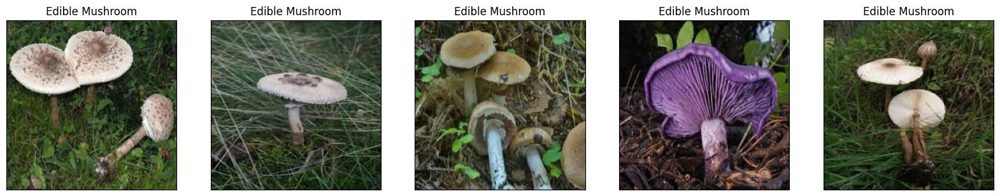

Folder: Edible Mushroom
Jumlah gambar: 1166
Tipe data gambar: <class 'numpy.ndarray'>
Ukuran gambar: (224, 224, 3)




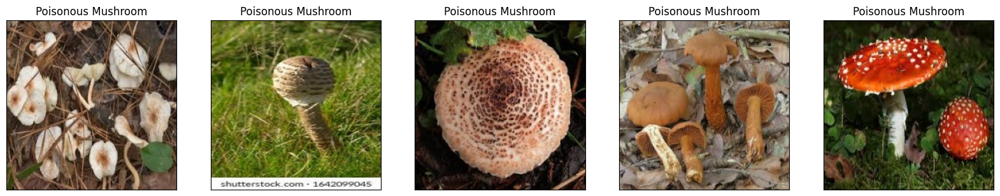

Folder: Poisonous Mushroom
Jumlah gambar: 2206
Tipe data gambar: <class 'numpy.ndarray'>
Ukuran gambar: (224, 224, 3)




In [ ]:
# List dari folder yang ingin Anda cek
folders = ['Edible Mushroom', 'Poisonous Mushroom']

# Dictionary untuk menyimpan data
data = {}

for folder in folders:
    folder_path = os.path.join(dataset_path, folder)

    # List semua file dalam folder
    files = os.listdir(folder_path)

    # List untuk menyimpan gambar
    images = []

    for file in files:
        # Baca gambar
        img = cv2.imread(os.path.join(folder_path, file))

        # Tambahkan gambar ke list
        images.append(img)

    # Tambahkan list gambar ke dictionary data
    data[folder] = images

# Ambil nama folder dan gambar dari dictionary data
for folder, images in data.items():
    # Buat figure baru
    fig = plt.figure(figsize=(20, 4))

    # Ambil 5 gambar pertama dari setiap folder
    for i in range(5):
        # Buat subplot untuk setiap gambar
        ax = fig.add_subplot(1, 5, i+1, xticks=[], yticks=[])

        # Tampilkan gambar
        ax.imshow(cv2.cvtColor(images[i], cv2.COLOR_BGR2RGB))

        # Beri judul berdasarkan nama folder
        ax.set_title(folder)

    # Tampilkan plot
    plt.show()

    # Cetak informasi tentang dataset
    print(f"Folder: {folder}")
    print(f"Jumlah gambar: {len(images)}")
    print(f"Tipe data gambar: {type(images[0])}")
    print(f"Ukuran gambar: {images[0].shape}")

    # Cetak pembatas
    print("\n")

In [ ]:
# List untuk menyimpan semua data
all_data = []

# Ambil nama folder dan gambar dari dictionary data
for folder, images in data.items():
    for img in images:
        # Dapatkan file path
        file_path = os.path.join(folder, str(img))

        # Tambahkan informasi gambar ke list
        all_data.append([file_path, folder, str(img.shape)])

# Ubah list menjadi DataFrame
df = pd.DataFrame(all_data, columns=['File Path', 'Label', 'Image Size'])

print(df.all)

# Tampilkan tipe data
print("\nTipe Data:\n")
print(df.dtypes)

# Tampilkan jumlah data
print("\nJumlah Data:\n")
print(df.count())

<bound method DataFrame.all of                                               File Path               Label  \
0     Edible Mushroom\[[[ 71 104  89]\n  [ 46  79  6...     Edible Mushroom   
1     Edible Mushroom\[[[ 80  96  72]\n  [ 76  92  6...     Edible Mushroom   
2     Edible Mushroom\[[[ 25  20  19]\n  [ 29  24  2...     Edible Mushroom   
3     Edible Mushroom\[[[  4   6   6]\n  [  4   6   ...     Edible Mushroom   
4     Edible Mushroom\[[[48 63 59]\n  [50 65 61]\n  ...     Edible Mushroom   
...                                                 ...                 ...   
3367  Poisonous Mushroom\[[[202 208 251]\n  [202 208...  Poisonous Mushroom   
3368  Poisonous Mushroom\[[[ 90 176 152]\n  [ 89 175...  Poisonous Mushroom   
3369  Poisonous Mushroom\[[[52 90 90]\n  [34 70 70]\...  Poisonous Mushroom   
3370  Poisonous Mushroom\[[[ 14  30  47]\n  [ 22  32...  Poisonous Mushroom   
3371  Poisonous Mushroom\[[[ 85  86  82]\n  [ 80  81...  Poisonous Mushroom   

         Image Size 

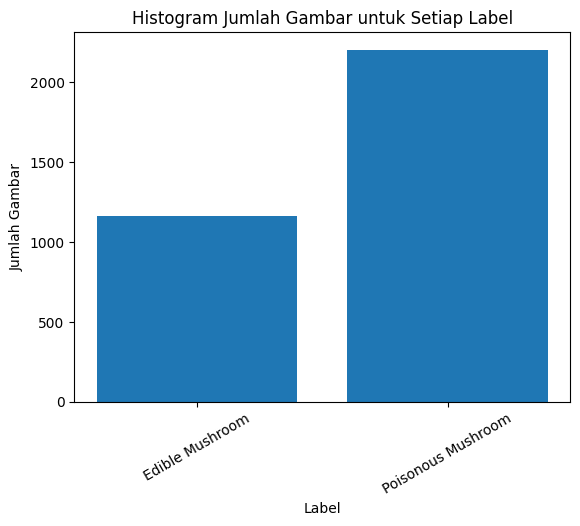

In [ ]:
folders = ['Edible Mushroom', 'Poisonous Mushroom']

# List untuk menyimpan jumlah gambar
num_images = []

# Ambil nama folder dan gambar dari dictionary data
for folder, images in data.items():
    num_images.append(len(images))

# Buat histogram
plt.bar(data.keys(), num_images)

# Beri label sumbu
plt.xlabel('Label')
plt.ylabel('Jumlah Gambar')

# Putar label pada sumbu x
plt.xticks(rotation=30)

# Beri judul plot
plt.title('Histogram Jumlah Gambar untuk Setiap Label')

# Tampilkan plot
plt.show()

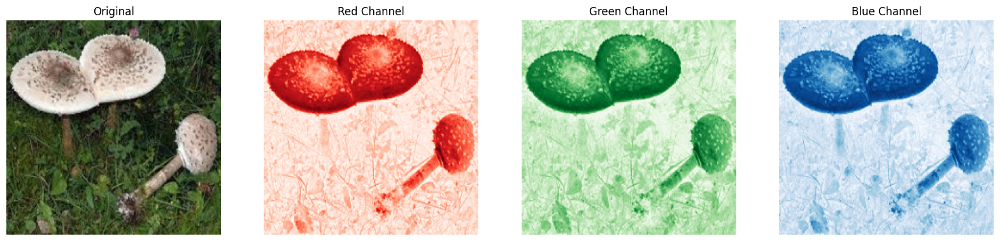

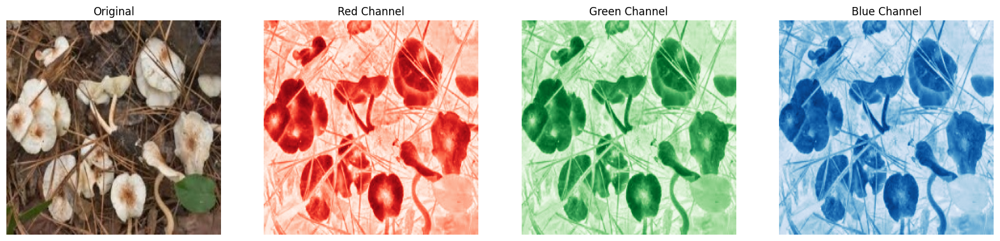

In [ ]:
# Ambil nama folder dan gambar dari dictionary data
for folder, images in data.items():
    # Ambil gambar pertama dari setiap folder
    img = images[0]

    # Pisahkan setiap channel warna
    r, g, b = cv2.split(img)

    # Buat figure baru
    fig, axs = plt.subplots(1, 4, figsize=(20, 5))

    # Tampilkan gambar asli
    axs[0].imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
    axs[0].set_title('Original')

    # Tampilkan channel merah
    axs[1].imshow(r, cmap='Reds')
    axs[1].set_title('Red Channel')

    # Tampilkan channel hijau
    axs[2].imshow(g, cmap='Greens')
    axs[2].set_title('Green Channel')

    # Tampilkan channel biru
    axs[3].imshow(b, cmap='Blues')
    axs[3].set_title('Blue Channel')

    # Hilangkan axis
    for ax in axs:
        ax.axis('off')

    # Tampilkan plot
    plt.show()

    # Cetak pembatas
    print("\n")


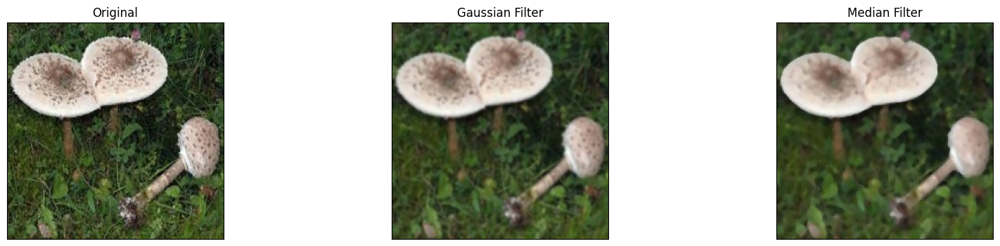

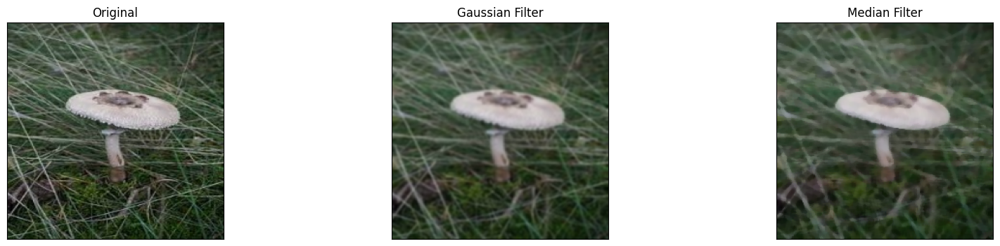

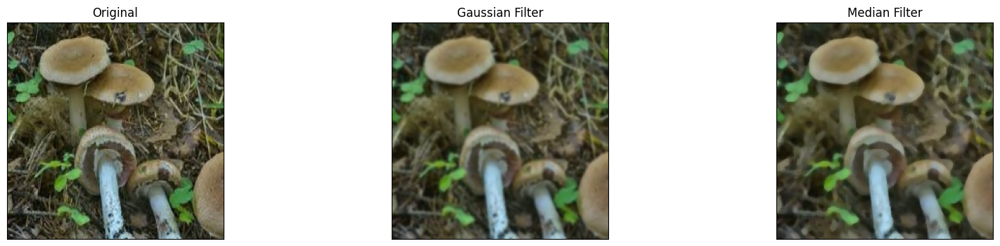

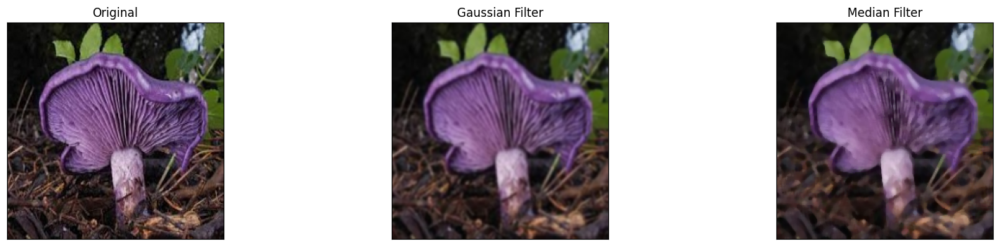

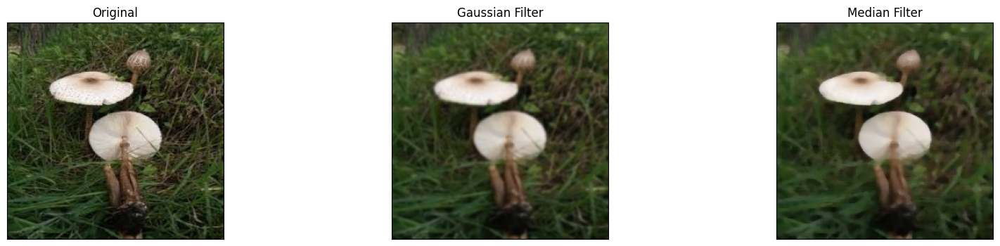

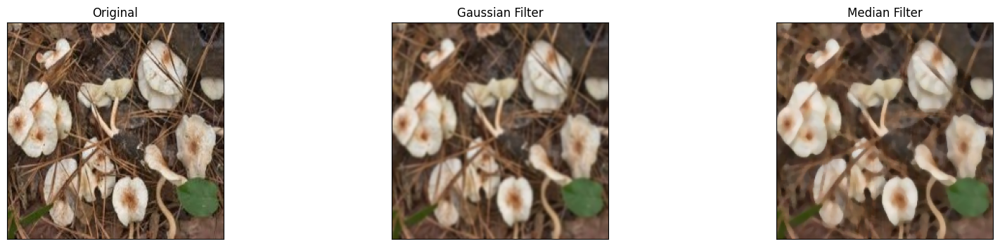

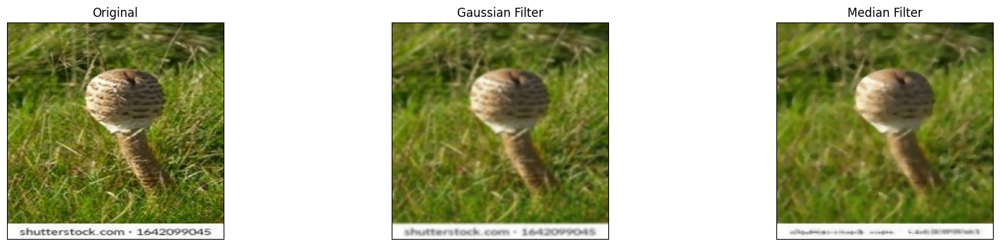

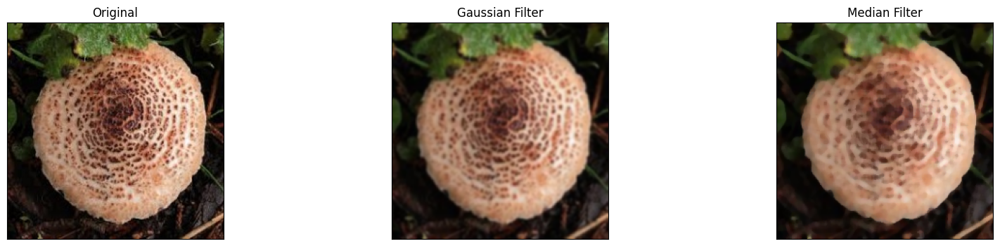

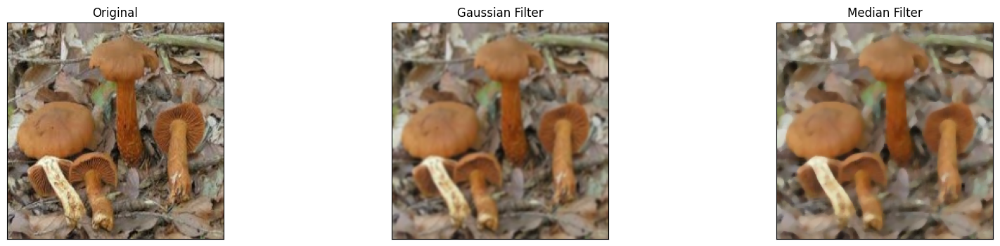

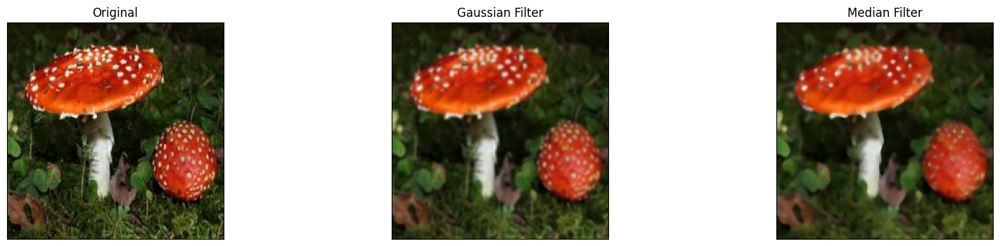

In [ ]:
# List dari folder yang ingin Anda cek
folders = ['Edible Mushroom', 'Poisonous Mushroom']

# Dictionary untuk menyimpan data
data = {}

for folder in folders:
    folder_path = os.path.join(dataset_path, folder)

    # List semua file dalam folder
    files = os.listdir(folder_path)

    # List untuk menyimpan gambar
    images = []

    for file in files:
        # Baca gambar
        img = cv2.imread(os.path.join(folder_path, file))

        # Tambahkan gambar ke list
        images.append(img)

    # Tambahkan list gambar ke dictionary data
    data[folder] = images

# Ambil nama folder dan gambar dari dictionary data
for folder, images in data.items():
    # Reduksi noise menggunakan filter Gaussian dan median
    for i in range(5):
        # Buat figure baru
        fig = plt.figure(figsize=(20, 4))

        # Buat subplot untuk gambar asli
        ax = fig.add_subplot(1, 3, 1, xticks=[], yticks=[])
        ax.imshow(cv2.cvtColor(images[i], cv2.COLOR_BGR2RGB))
        ax.set_title("Original")

        # Buat subplot untuk gambar dengan filter Gaussian
        gaussian_filtered = cv2.GaussianBlur(images[i], (5, 5), 0)
        ax = fig.add_subplot(1, 3, 2, xticks=[], yticks=[])
        ax.imshow(cv2.cvtColor(gaussian_filtered, cv2.COLOR_BGR2RGB))
        ax.set_title("Gaussian Filter")

        # Buat subplot untuk gambar dengan filter median
        median_filtered = cv2.medianBlur(images[i], 5)
        ax = fig.add_subplot(1, 3, 3, xticks=[], yticks=[])
        ax.imshow(cv2.cvtColor(median_filtered, cv2.COLOR_BGR2RGB))
        ax.set_title("Median Filter")

        # Tampilkan plot
        plt.show()

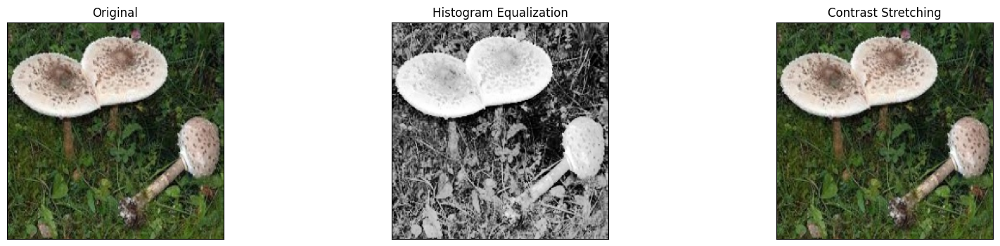

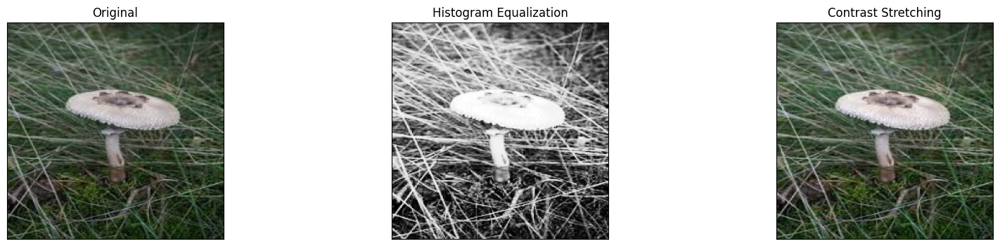

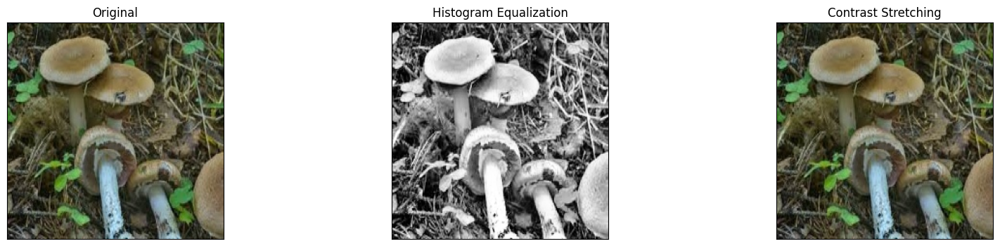

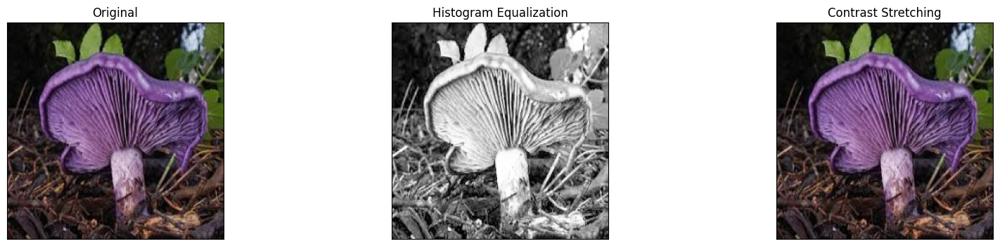

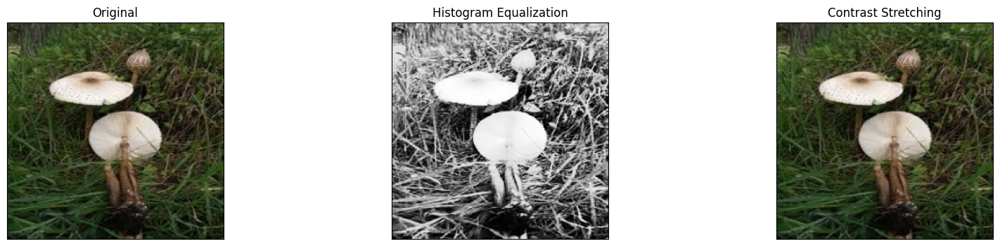

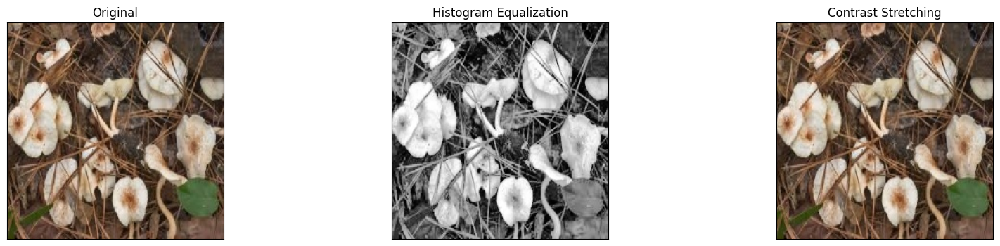

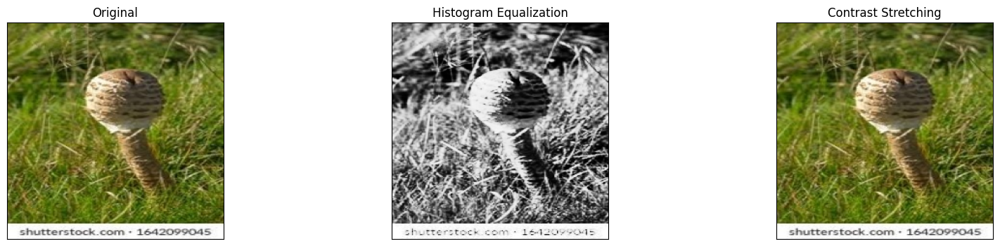

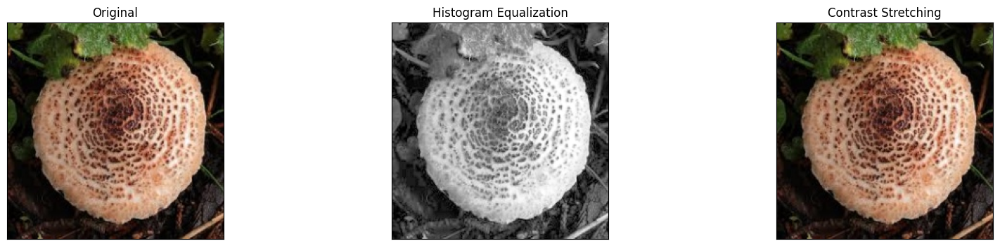

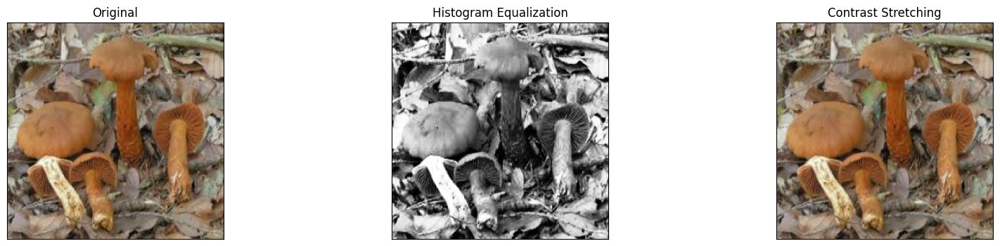

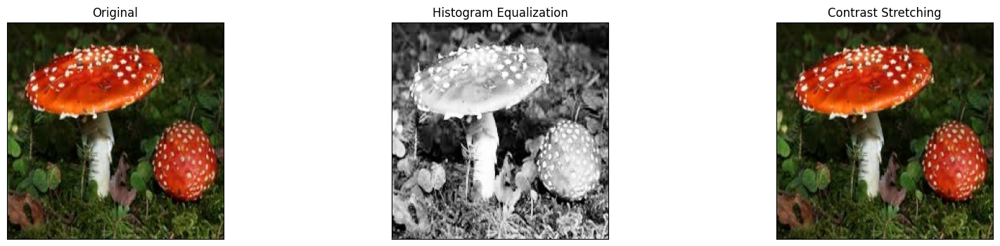

In [ ]:
# List dari folder yang ingin Anda cek
folders = ['Edible Mushroom', 'Poisonous Mushroom']

# Dictionary untuk menyimpan data
data = {}

for folder in folders:
    folder_path = os.path.join(dataset_path, folder)

    # List semua file dalam folder
    files = os.listdir(folder_path)

    # List untuk menyimpan gambar
    images = []

    for file in files:
        # Baca gambar
        img = cv2.imread(os.path.join(folder_path, file))

        # Tambahkan gambar ke list
        images.append(img)

    # Tambahkan list gambar ke dictionary data
    data[folder] = images

# Ambil nama folder dan gambar dari dictionary data
for folder, images in data.items():
    # Peningkatan gambar menggunakan histogram equalization dan contrast stretching
    for i in range(5):
        # Buat figure baru
        fig = plt.figure(figsize=(20, 4))

        # Buat subplot untuk gambar asli
        ax = fig.add_subplot(1, 3, 1, xticks=[], yticks=[])
        ax.imshow(cv2.cvtColor(images[i], cv2.COLOR_BGR2RGB))
        ax.set_title("Original")

        # Buat subplot untuk gambar dengan histogram equalization
        img_gray = cv2.cvtColor(images[i], cv2.COLOR_BGR2GRAY)
        equalized_img = cv2.equalizeHist(img_gray)
        ax = fig.add_subplot(1, 3, 2, xticks=[], yticks=[])
        ax.imshow(equalized_img, cmap='gray')
        ax.set_title("Histogram Equalization")

        # Buat subplot untuk gambar dengan contrast stretching
        # Normalisasi gambar ke range 0-255
        normalized_img = cv2.normalize(images[i], None, alpha=0, beta=255, norm_type=cv2.NORM_MINMAX)
        ax = fig.add_subplot(1, 3, 3, xticks=[], yticks=[])
        ax.imshow(cv2.cvtColor(normalized_img, cv2.COLOR_BGR2RGB))
        ax.set_title("Contrast Stretching")

        # Tampilkan plot
        plt.show()


In [ ]:
# Path ke dataset Anda
dataset_path = 'C:/Users/fatur/Documents/Datasets/Dataset edible and poisonous fungi'

# List dari folder yang ingin Anda cek
folders = ['Edible Mushroom', 'Poisonous Mushroom']

# Fungsi untuk melakukan noise reduction dan image sharpening
def process_image(image_path):
    # Baca gambar
    img = cv2.imread(image_path)

    # Lakukan noise reduction dengan Gaussian filter
    img = cv2.GaussianBlur(img, (5, 5), 0)

    # Lakukan image sharpening dengan contrast stretching
    # Normalisasi gambar ke range 0-255
    img = cv2.normalize(img, None, alpha=0, beta=255, norm_type=cv2.NORM_MINMAX)

    return img

# List untuk menyimpan semua data
all_data = []

for folder in folders:
    folder_path = os.path.join(dataset_path, folder)

    # List semua file dalam folder
    files = os.listdir(folder_path)

    for file in files:
        # Dapatkan file path
        file_path = os.path.join(folder_path, file)

        # Proses gambar
        img = process_image(file_path)

        # Tambahkan informasi gambar ke list
        all_data.append([img, folder])

# Ubah list menjadi DataFrame
df = pd.DataFrame(all_data, columns=['Image', 'Label'])

# Pisahkan data menjadi training dan testing
train_df, test_df = train_test_split(df, test_size=0.2, random_state=42, stratify=df['Label'])

# Ubah gambar menjadi array dan label menjadi integer
x_train = np.array(train_df['Image'].tolist())
y_train = np.array(train_df['Label'].tolist())
x_test = np.array(test_df['Image'].tolist())
y_test = np.array(test_df['Label'].tolist())

# Ubah label menjadi one-hot encoding
le = LabelEncoder()
y_train = le.fit_transform(y_train)
y_train = to_categorical(y_train)
y_test = le.transform(y_test)
y_test = to_categorical(y_test)

In [ ]:
# Jumlah kelas dalam dataset Anda
num_classes = 2

# Buat model dasar
base_model = EfficientNetV2B0(weights='imagenet', include_top=False, input_shape=(224, 224, 3))

# Buat model akhir
model = Sequential()
model.add(base_model)
model.add(Flatten())
model.add(Dense(1024, activation='relu', kernel_regularizer=l2(0.01)))
model.add(Dropout(0.5))
model.add(Dense(num_classes, activation='softmax'))

# Kompilasi model
model.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])

# Latih model
history = model.fit(x_train, y_train, validation_data=(x_test, y_test), epochs=10)

Epoch 1/10
85/85 ━━━━━━━━━━━━━━━━━━━━ 220s 2s/step - accuracy: 0.6325 - loss: 22.2850 - val_accuracy: 0.7615 - val_loss: 8.4709
Epoch 2/10
85/85 ━━━━━━━━━━━━━━━━━━━━ 177s 2s/step - accuracy: 0.8576 - loss: 6.3243 - val_accuracy: 0.7600 - val_loss: 4.6793
Epoch 3/10
85/85 ━━━━━━━━━━━━━━━━━━━━ 182s 2s/step - accuracy: 0.9002 - loss: 4.1704 - val_accuracy: 0.7259 - val_loss: 5.8037
Epoch 4/10
85/85 ━━━━━━━━━━━━━━━━━━━━ 183s 2s/step - accuracy: 0.8974 - loss: 4.9008 - val_accuracy: 0.7793 - val_loss: 5.4350
Epoch 5/10
85/85 ━━━━━━━━━━━━━━━━━━━━ 191s 2s/step - accuracy: 0.9105 - loss: 4.3641 - val_accuracy: 0.7630 - val_loss: 3.7403
Epoch 6/10
85/85 ━━━━━━━━━━━━━━━━━━━━ 191s 2s/step - accuracy: 0.9413 - loss: 2.7172 - val_accuracy: 0.7926 - val_loss: 2.4057
Epoch 7/10
85/85 ━━━━━━━━━━━━━━━━━━━━ 180s 2s/step - accuracy: 0.9584 - loss: 1.6882 - val_accuracy: 0.7941 - val_loss: 2.4044
Epoch 8/10
85/85 ━━━━━━━━━━━━━━━━━━━━ 179s 2s/step - accuracy: 0.9503 - loss: 1.7610 - val_accuracy: 0.7926 - 

In [ ]:
model.summary()
model.save('my_model.h5')

# Simpan model dalam format .h5
model.save('C:/Users/fatur/Downloads/my_model.h5')

Model: "sequential"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ efficientnetv2-b0 (Functional)       │ (None, 7, 7, 1280)          │       5,919,312 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ flatten (Flatten)                    │ (None, 62720)               │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense (Dense)                        │ (None, 1024)                │      64,226,304 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout (Dropout)                    │ (None, 1024)                │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_1 (Dense)                      │ (None, 2)                   │           2,050 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 210,321,784 (802.31 MB)

 Trainable params: 70,087,058 (267.36 MB)

 Non-trainable params: 60,608 (236.75 KB)

 Optimizer params: 140,174,118 (534.72 MB)

22/22 ━━━━━━━━━━━━━━━━━━━━ 12s 427ms/step
True Positives: 347
True Negatives: 164
False Positives: 69
False Negatives: 95
                    precision    recall  f1-score   support

   Edible Mushroom       0.63      0.70      0.67       233
Poisonous Mushroom       0.83      0.79      0.81       442

          accuracy                           0.76       675
         macro avg       0.73      0.74      0.74       675
      weighted avg       0.76      0.76      0.76       675



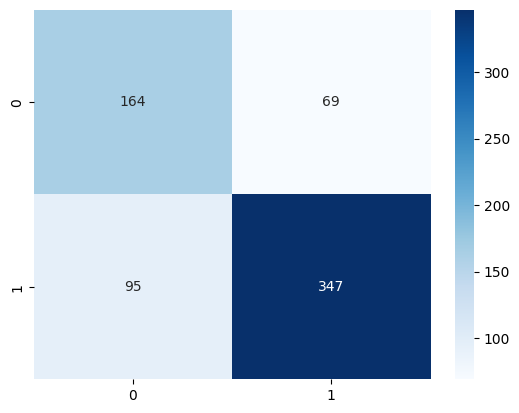

In [ ]:
# Prediksi label untuk data testing
y_pred = model.predict(x_test)
y_pred_classes = np.argmax(y_pred, axis=1)

# Dapatkan label sebenarnya
y_true = np.argmax(y_test, axis=1)

# Hitung confusion matrix
cm = confusion_matrix(y_true, y_pred_classes)

# Tampilkan confusion matrix dengan warna biru
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues')

# Hitung TP, TN, FP, FN
TP = cm[1, 1]
TN = cm[0, 0]
FP = cm[0, 1]
FN = cm[1, 0]

print(f"True Positives: {TP}")
print(f"True Negatives: {TN}")
print(f"False Positives: {FP}")
print(f"False Negatives: {FN}")

# Hitung dan tampilkan classification report
report = classification_report(y_true, y_pred_classes, target_names=folders)
print(report)

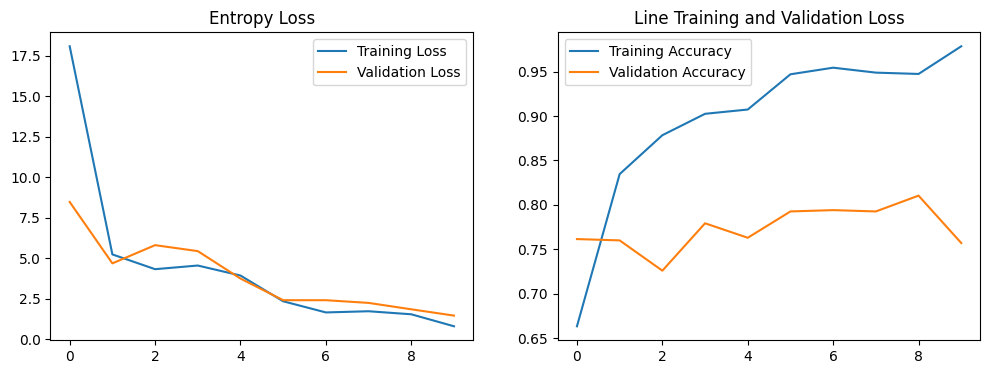

In [ ]:
# Buat grafik entropy loss
plt.figure(figsize=(12, 4))
plt.subplot(1, 2, 1)
plt.plot(history.history['loss'], label='Training Loss')
plt.plot(history.history['val_loss'], label='Validation Loss')
plt.title('Entropy Loss')
plt.legend()

# Buat grafik line training dan validation loss
plt.subplot(1, 2, 2)
plt.plot(history.history['accuracy'], label='Training Accuracy')
plt.plot(history.history['val_accuracy'], label='Validation Accuracy')
plt.title('Line Training and Validation Loss')
plt.legend()

plt.show()